# Extra Data Visualization Techniques

### Pandas Built-In Data Viz

These plot types are built into pandas but aren't as nice however they are very convenient to run quickly

Highly recommend using Seaborn because it's much faster but this is more informitive

Doesn't offer much customization

Load a dataset

`df = sns.load_dataset('taxis')`

###### Historgram

`df['fare'].plot.hist()` or `df['fare'].plot(kind='hist')`

###### Scatter

`df.plot.scatter(x='total', y='tip')`

##### Box

`df['total'].plot.box()` or `df.plot.box(y='total')`



### Plotly

This is a really cool library for interactive Visualizations

https://plotly.com/python/

###### Getting started

`
pip install plotly
import plotly.express as px
`

Have to call objects with `px.graph_type` and then include the Data Frame in the call

Does not work well with `Nan` values, so there are times we have to drop them but it's better to clean the data (will learn in the future)

###### Histogram

`
fig = px.histogram(df, x='total')
fig.show()
`

###### Box

`
fig = px.box(df, x='total')
fig.show()
`

###### Scatter

`px.scatter(df.dropna(), x='fare', y='total')`

###### Adding Hue (Categorical Columns)

`color='categorical column'`

`px.box(df.dropna(), x='pickup_borough', y='total', color='payment')`

###### Choropleth Maps with Plotly

In order to do global maps we need a few things in place

1. GeoJson File with lat/long coordinates of each location
- https://github.com/apisit/thailand.json

2. DataFrame to put onto the map

Examples

`
df = px.data.election()
geojson = px.data.election_geojson()
fig = px.choropleth(df, geojson=geojson, color="Bergeron",
                    locations="district", featureidkey="properties.district",
                    projection="mercator"
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()
`

For Thailand specifically

`
with open('thailand.json') as response:
    geojson_thailand = json.load(response) # get the geojson data loaded
jangwat = [geojson_thailand['features'][i]['properties']['name'] for i in range(len(geojson_thailand['features']))]
col1 = np.random.rand(len(districts))
col2 = np.random.randint(0,100,len(districts))
data_thailand = list(zip(districts, col1, col2))
df_thailand = pd.DataFrame(data_thailand, columns=['jangwat', 'col1', 'col2']) # Create the dataframe with the jangwat as a column
fig = px.choropleth(df_thailand, geojson=geojson_thailand, color="col2",
                    locations="jangwat", featureidkey="properties.name",
                    projection="mercator", scope='asia', hover_data=['col1']
                   )
fig.show()
`

In [17]:
import pandas as pd
import numpy as np
import seaborn as sns

# Plotly Interactive Visualizations
import plotly.express as px

%matplotlib inline

In [7]:
df = sns.load_dataset('taxis')
df.head()

,pickup,dropoff,passengers,distance,fare,tip,tolls,total,color,payment,pickup_zone,dropoff_zone,pickup_borough,dropoff_borough
0,2019-03-23 20:21:09,2019-03-23 20:27:24,1,1.60,7.0,2.15,0.0,12.95,yellow,credit card,Lenox Hill West,UN/Turtle Bay South,Manhattan,Manhattan
1,2019-03-04 16:11:55,2019-03-04 16:19:00,1,0.79,5.0,0.00,0.0,9.30,yellow,cash,Upper West Side South,Upper West Side South,Manhattan,Manhattan
2,2019-03-27 17:53:01,2019-03-27 18:00:25,1,1.37,7.5,2.36,0.0,14.16,yellow,credit card,Alphabet City,West Village,Manhattan,Manhattan
3,2019-03-10 01:23:59,2019-03-10 01:49:51,1,7.70,27.0,6.15,0.0,36.95,yellow,credit card,Hudson Sq,Yorkville West,Manhattan,Manhattan
4,2019-03-30 13:27:42,2019-03-30 13:37:14,3,2.16,9.0,1.10,0.0,13.40,yellow,credit card,Midtown East,Yorkville West,Manhattan,Manhattan


<AxesSubplot:ylabel='Frequency'>

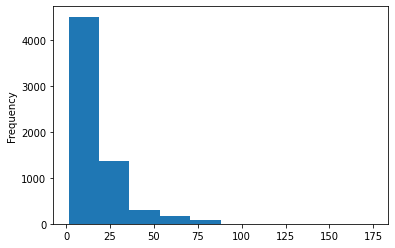

In [11]:
# Pandas Built-in Data Visualizations

df['total'].plot.hist(bins=10)

<AxesSubplot:xlabel='total', ylabel='tip'>

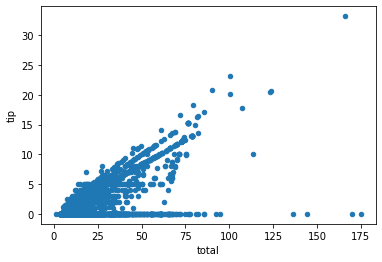

In [13]:
# Scatter plot using pandas built-in visualization

df.plot.scatter(x='total', y='tip')

<AxesSubplot:>

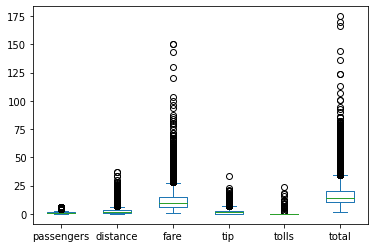

In [15]:
# Box Plot

df.plot.box()

In [20]:
# Plotly Visualizations

# Plotly does not like NAN values at all

# 2 options, drop nan values or fill nan values with a value of your choice

fig = px.histogram(df.dropna(), x='total', color='payment')
fig.show()


In [23]:
fig = px.violin(df, x='total', color='color')
fig.show()

In [25]:
# Plotly Scatter Plot

px.scatter(df.dropna(), x='fare', y='total', color='payment')

In [33]:
# Choropleth Maps


# Geographical JSON File

# JSON - Java Server Object Notation
# {'key':'value'}

from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

counties




{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'GEO_ID': '0500000US01001',
    'STATE': '01',
    'COUNTY': '001',
    'NAME': 'Autauga',
    'LSAD': 'County',
    'CENSUSAREA': 594.436},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-86.496774, 32.344437],
      [-86.717897, 32.402814],
      [-86.814912, 32.340803],
      [-86.890581, 32.502974],
      [-86.917595, 32.664169],
      [-86.71339, 32.661732],
      [-86.714219, 32.705694],
      [-86.413116, 32.707386],
      [-86.411172, 32.409937],
      [-86.496774, 32.344437]]]},
   'id': '01001'},
  {'type': 'Feature',
   'properties': {'GEO_ID': '0500000US01009',
    'STATE': '01',
    'COUNTY': '009',
    'NAME': 'Blount',
    'LSAD': 'County',
    'CENSUSAREA': 644.776},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-86.577799, 33.765316],
      [-86.759144, 33.840617],
      [-86.953664, 33.815297],
      [-86.954305, 33.844862],
      [-86.96296, 33.844865],
      [-86.9

In [32]:
# Chorpleth Data Frame

df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",dtype={"fips": str})
df.head()

,fips,unemp
0,01001,5.3
1,01003,5.4
2,01005,8.6
3,01007,6.6
4,01009,5.5


In [37]:
fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 15),
                           scope="world",
                           labels={'unemp':'My New Name for the hover'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [39]:
# Choropleth map for Thailand


# GeoJson File

with open('thailand.json') as response:
    geojson_thailand = json.load(response)

geojson_thailand


{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'name': 'Mae Hong Son'},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[98.0859298100001, 19.773161112000082],
      [98.1113546150001, 19.77714019800007],
      [98.13223189300004, 19.76605560300007],
      [98.1720227460001, 19.731561584000104],
      [98.20592248500009, 19.72148468100005],
      [98.21326053900009, 19.71776397800005],
      [98.21791141800003, 19.70797129300007],
      [98.21667118300007, 19.68745575000011],
      [98.21915165200005, 19.676991272000066],
      [98.23754846200006, 19.664692281000043],
      [98.26276656200014, 19.669859924000036],
      [98.30731164500003, 19.689987895000087],
      [98.34761926300007, 19.690633851000086],
      [98.39443811100011, 19.686344706000114],
      [98.43960331200009, 19.68773997000008],
      [98.47453658000006, 19.705309957000054],
      [98.47780068602651, 19.705629272236536],
      [98.47619103358932, 19.693707791081664],
      [

In [51]:
len_jangwat = len(geojson_thailand['features'])
# print(len_jangwat)
jangwat = [geojson_thailand['features'][i]['properties']['name'] for i in range(len_jangwat)]
# print(jangwat)

col1 = np.random.randint(1,99,len_jangwat)
col2 = np.random.rand(len_jangwat)

# print(col1)
# print(col2)

data = list(zip(jangwat, col1, col2))
# print(data)
df_thailand = pd.DataFrame(data, columns=['jangwat', 'col1', 'col2'])
df_thailand.head()

,jangwat,col1,col2
0,Mae Hong Son,23,0.225332
1,Chumphon,36,0.258998
2,Nakhon Si Thammarat,94,0.390438
3,Phuket,74,0.055734
4,Phangnga,86,0.221133


In [55]:
# Actual Mapping of data

px.choropleth(df_thailand, geojson=geojson_thailand, color="col1",
                    locations="jangwat", featureidkey="properties.name",
                    projection="kavrayskiy7", scope='asia', hover_data=['col2']
                   )